<a href="https://colab.research.google.com/github/mzohaibnasir/macvds/blob/main/personal_celebADCGAN(2).ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
import torch
print(torch.__version__)

2.1.0.dev20230601+cu121


In [ ]:
device  = torch.device('cuda:0') if torch.cuda.is_available() else 'cpu'
device

device(type='cuda', index=0)

In [ ]:
# from google.colab import files
# uploaded = files.upload()

In [ ]:
!7z x ./dataMain.7z

/bin/bash: line 1: 7z: command not found


In [ ]:
from torch import nn
from torch.utils.data import DataLoader
from torchvision import transforms
import torch.optim as optim
import matplotlib.pyplot as plt
import os
from torchvision import datasets


In [ ]:
batch_size = 128

image_size = 64

nc=3

nz = 100

# size of features map in G
ngf = 64

# size of features map in D
ndf = 64



In [ ]:
transform = transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ])

transform

Compose(
    Resize(size=64, interpolation=bilinear, max_size=None, antialias=warn)
    CenterCrop(size=(64, 64))
    ToTensor()
    Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
)

In [ ]:
dataset = datasets.ImageFolder(
    './xx/',
    transform = transform
)

In [ ]:
dataloader = torch.utils.data.DataLoader(
    dataset,
    batch_size,
    shuffle=True,
    pin_memory=True,
    num_workers=32
)

dataloader

In [ ]:
len(dataloader),len(dataloader.dataset)

(1583, 202599)

In [ ]:
train_features_batch, train_labels_batch = next(iter(dataloader))
train_features_batch.shape , train_labels_batch.shape

(torch.Size([128, 3, 64, 64]), torch.Size([128]))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 63.5, 63.5, -0.5)

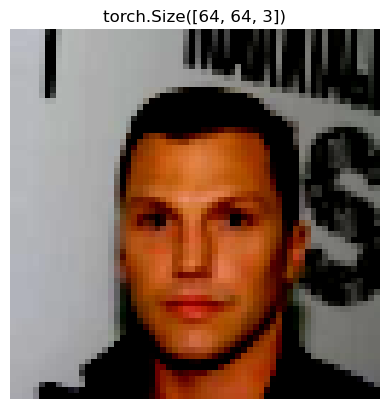

In [ ]:
import numpy as np
sample_image = train_features_batch[0]
sample_image= torch.permute( sample_image, [1,2,0])
# sample_image= np.transpose( sample_image)

plt.imshow(sample_image)
plt.title(sample_image.shape)
plt.axis("off")

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


torch.Size([3, 64, 64])


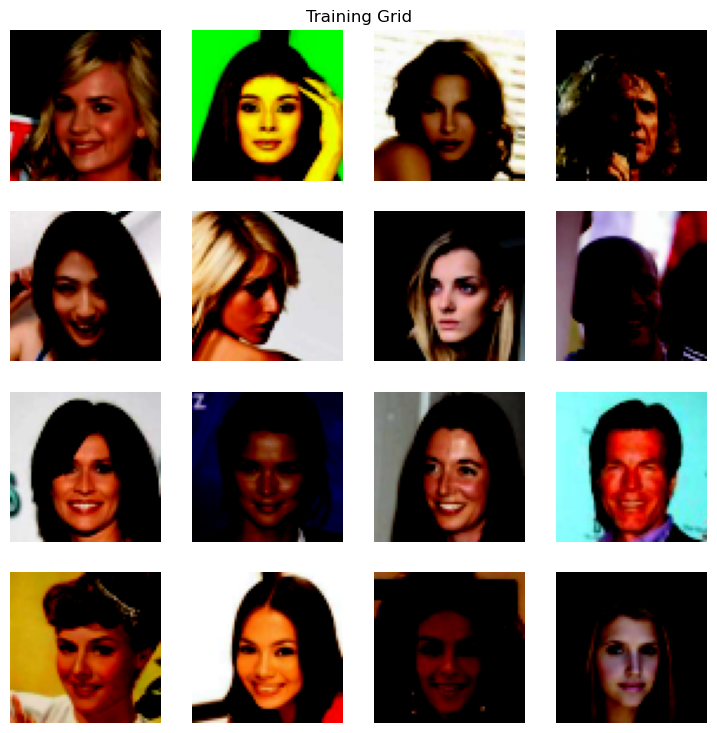

In [ ]:
fig = plt.figure(figsize=(9,9))
plt.title("Training Grid")
plt.axis("off")

torch.manual_seed(42)
rows,cols = 4,4

for i in range(1,rows*cols+1):

  random_idx = torch.randint(0, len(dataset), size=[1])
  # print(random_idx)
  random_idx = random_idx.item()
  # print(random_idx)


  img , label = next(iter(dataloader))
  img = img[0]
  print(img.shape)

  fig.add_subplot(rows, cols, i)

  img= torch.permute( img, [1,2,0])
  plt.imshow(img)

  # print(img.shape)
  plt.axis("off")


plt.show()




Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


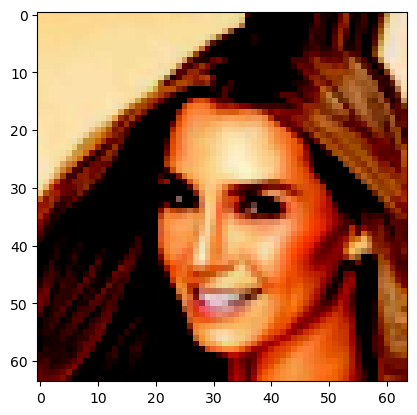

In [ ]:
# this is dataset not dataloader
img , label = dataset[0]
img = torch.permute( img, [1,2,0])


plt.imshow(img)

In [ ]:
x, y  = next(iter(dataloader))
x.shape

torch.Size([128, 3, 64, 64])

In [ ]:
def create_noise( batch_size, z_size):
  return torch.rand(batch_size, z_size,1,1)

z = create_noise(64, nz)

In [ ]:
# class GeneratorV0(nn.Module):
#   def __init__(self, ):
#     super().__init__()
#     self.main = nn.Sequential(
#           # z input_shape : torch.Size([64, 100, 1, 1])
#           nn.ConvTranspose2d( 100, 64* 8 ,4,1,0,bias=False),
#           nn.BatchNorm2d( 64*8 ),
#           nn.ReLU(True)

#       )

#   def forward(self, input):
#     print("before:",input.size())
#     input = self.main(input)
#     print("after:",input.shape)
#     return input



# model = GeneratorV0()
# y = model(z)


In [ ]:
class Generator(nn.Module):
  def __init__(self, ):
    super().__init__()
    self.main = nn.Sequential(
          # z input_shape : torch.Size([64, 100, 1, 1]), ngf=64c
          nn.ConvTranspose2d( 100, 64* 8 ,4,1,0,bias=False),
          nn.BatchNorm2d( 64*8 ),
          nn.ReLU(True),

          nn.ConvTranspose2d(  64* 8 , 64* 4,4,2,1,bias=False),
          nn.BatchNorm2d( 64*4 ),
          nn.ReLU(True),

          nn.ConvTranspose2d(  64* 4 ,64*2, 4,2,1,bias=False),
          nn.BatchNorm2d( 64*2 ),
          nn.ReLU(True),

          nn.ConvTranspose2d( 64* 2,64 ,4,2,1,bias=False),
          nn.BatchNorm2d( 64 ),
          nn.ReLU(True),

          nn.ConvTranspose2d( 64 ,3 ,4 , 2 ,1,bias=False),
          nn.Tanh()



      )

  def forward(self, input):
    # print("before:",input.size())
    input = self.main(input)
    # print("after:",input.shape)
    return input



model = Generator()
y = model(z)


In [ ]:
# class DiscriminatorV0(nn.Module):
#   def __init__(self):
#     super().__init__()
#     self.main = nn.Sequential(
#       # input is ``3 x 64 x 64``
#       nn.Conv2d( 3, 64, 4,2,1,bias=False),
#       nn.LeakyReLU(0.2, inplace=True)
#     )




#   def forward(self, input):
#     print("before:",input.size())
#     input = self.main(input)
#     print("after:",input.shape)
#     return input

# model = DiscriminatorV0()



# z = torch.rand(128, 3,64,64)
# x = torch.rand( 3,64,64)


# y = model(z)
# y = model(x)




In [ ]:
class Discriminator(nn.Module):
  def __init__(self):
    super().__init__()
    self.main = nn.Sequential(
      # input is ``3 x 64 x 64``
      nn.Conv2d( 3, 64, 4,2,1,bias=False),
      nn.LeakyReLU(0.2, inplace=True),

      # 64*32*32
      nn.Conv2d(64, 64 * 2, 4, 2, 1, bias=False),
      nn.BatchNorm2d(64 * 2),
      nn.LeakyReLU(0.2, inplace=True),

      # 128*16*16
      nn.Conv2d(64*2, 64 * 4, 4, 2, 1, bias=False),
      nn.BatchNorm2d(64 * 4),
      nn.LeakyReLU(0.2, inplace=True),


      # 256*8*8
      nn.Conv2d(64*4, 64 * 8, 4, 2, 1, bias=False),
      nn.BatchNorm2d(64 * 8),
      nn.LeakyReLU(0.2, inplace=True),

      # 512*4*4

      nn.Conv2d(64 * 8, 1, 4, 1, 0, bias=False),
      nn.Sigmoid()
)


  def forward(self, input):
    # print("before:",input.size())
    input = self.main(input)
    # print("after:",input.shape)
    return input

model = Discriminator()



z = torch.rand(128, 3,64,64)


y = model(z)



In [ ]:
netG = Generator().to(device)
netD = Discriminator().to(device)
netG, netD

(Generator(
   (main): Sequential(
     (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
     (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (2): ReLU(inplace=True)
     (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (5): ReLU(inplace=True)
     (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (8): ReLU(inplace=True)
     (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
     (11): ReLU(inplace=True)
     (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
     (13

In [ ]:

criterion = nn.BCELoss()


real_label = 1.
fake_label = 0.

optimizerD = optim.Adam(netD.parameters(), lr=0.0002, betas=(0.5, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=0.0002, betas=(0.5, 0.999))


In [ ]:
# import torchvision.utils as vutils

# img_list = []
# G_losses = []
# D_losses = []
# iters = 0
# num_epochs = 5

# for epoch in range(num_epochs):
#     # For each batch in the dataloader
#     for i, data in enumerate(dataloader, 0):

#         netD.zero_grad()
#         real_cpu = data[0].to(device)
#         batch_size = real_cpu.size(0)
#         label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
#         # Forward pass real batch through D
#         output = netD(real_cpu).view(-1)
#         # Calculate loss on all-real batch
#         errD_real = criterion(output, label)
#         # Calculate gradients for D in backward pass
#         errD_real.backward()
#         D_x = output.mean().item()

#         ## Train with all-fake batch
#         # Generate batch of latent vectors
#         noise = torch.randn(batch_size, nz, 1, 1, device=device)
#         # Generate fake image batch with G
#         fake = netG(noise)
#         label.fill_(fake_label)
#         # Classify all fake batch with D
#         output = netD(fake.detach()).view(-1)
#         # Calculate D's loss on the all-fake batch
#         errD_fake = criterion(output, label)
#         # Calculate the gradients for this batch, accumulated (summed) with previous gradients
#         errD_fake.backward()
#         D_G_z1 = output.mean().item()
#         # Compute error of D as sum over the fake and the real batches
#         errD = errD_real + errD_fake
#         # Update D
#         optimizerD.step()

#         ############################
# #         G(x) = aximize log(D(G(z)))
#         ###########################
#         netG.zero_grad()
#         label.fill_(real_label)  # fake labels are real for generator cost
#         output = netD(fake).view(-1)
#         errG = criterion(output, label)
#         errG.backward()
#         D_G_z2 = output.mean().item()
#         optimizerG.step()

#         # Output training stats
#         if i % 50 == 0:
#             print(f'[{epoch:.4}/{num_epochs:.4}][{i:.4f}/{len(dataloader):.4f}]\tLoss_D: { errD.item():.4f}\tLoss_G: { errD.item():.4f}\tD(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}'
#                   % (epoch, num_epochs, i, len(dataloader),
#                      errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

#         # Save Losses for plotting later
#         G_losses.append(errG.item())
#         D_losses.append(errD.item())

#         # Check how the generator is doing by saving G's output on fixed_noise
#         if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
#             with torch.no_grad():
#                 fake = netG(create_noise(64, 100)).detach().cpu()
#             img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

#         iters += 1

In [ ]:
import torchvision.utils as vutils

img_list = []
G_losses = []
D_losses = []
iters = 0
num_epochs = 100

for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        netD.zero_grad()
        real_cpu = data[0].to(device)
        batch_size = real_cpu.size(0)
        label = torch.full((batch_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(batch_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
#         G(x) = aximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        output = netD(fake).view(-1)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        # Output training stats
        if i % 500 == 0:
            print(f'[{epoch}/{num_epochs}][{i}/{len(dataloader)}]\tLoss_D: { errD.item():.4f}\tLoss_G: { errD.item():.4f}\tD(x): {D_x:.4f}\tD(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}')


        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(create_noise(64, 100).to(device)).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

/home/tayyab/anaconda3/lib/python3.9/site-packages/torch/nn/modules/conv.py:459: UserWarning: Applied workaround for CuDNN issue, install nvrtc.so (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:80.)
  return F.conv2d(input, weight, bias, self.stride,


[0/100][0/1583]	Loss_D: 1.5165	Loss_G: 1.5165	D(x): 0.4280	D(G(z)): 0.4695 / 0.1169
[0/100][500/1583]	Loss_D: 0.6222	Loss_G: 0.6222	D(x): 0.6213	D(G(z)): 0.0377 / 0.0510
[0/100][1000/1583]	Loss_D: 0.5175	Loss_G: 0.5175	D(x): 0.8674	D(G(z)): 0.2832 / 0.0295
[0/100][1500/1583]	Loss_D: 0.4032	Loss_G: 0.4032	D(x): 0.8130	D(G(z)): 0.1542 / 0.1030
[1/100][0/1583]	Loss_D: 0.7288	Loss_G: 0.7288	D(x): 0.9060	D(G(z)): 0.4351 / 0.0087
[1/100][500/1583]	Loss_D: 0.7833	Loss_G: 0.7833	D(x): 0.5148	D(G(z)): 0.0134 / 0.0503
[1/100][1000/1583]	Loss_D: 0.7239	Loss_G: 0.7239	D(x): 0.5560	D(G(z)): 0.0302 / 0.3678
[1/100][1500/1583]	Loss_D: 0.4105	Loss_G: 0.4105	D(x): 0.9519	D(G(z)): 0.2871 / 0.0198
[2/100][0/1583]	Loss_D: 0.3073	Loss_G: 0.3073	D(x): 0.8778	D(G(z)): 0.1464 / 0.0706
[2/100][500/1583]	Loss_D: 0.2874	Loss_G: 0.2874	D(x): 0.9131	D(G(z)): 0.1606 / 0.0355
[2/100][1000/1583]	Loss_D: 0.2030	Loss_G: 0.2030	D(x): 0.9032	D(G(z)): 0.0894 / 0.0769
[2/100][1500/1583]	Loss_D: 0.3989	Loss_G: 0.3989	D(x): 

In [ ]:
# !pip install nvidia-pyindex
# !pip install nvidia-cuda-nvrtc

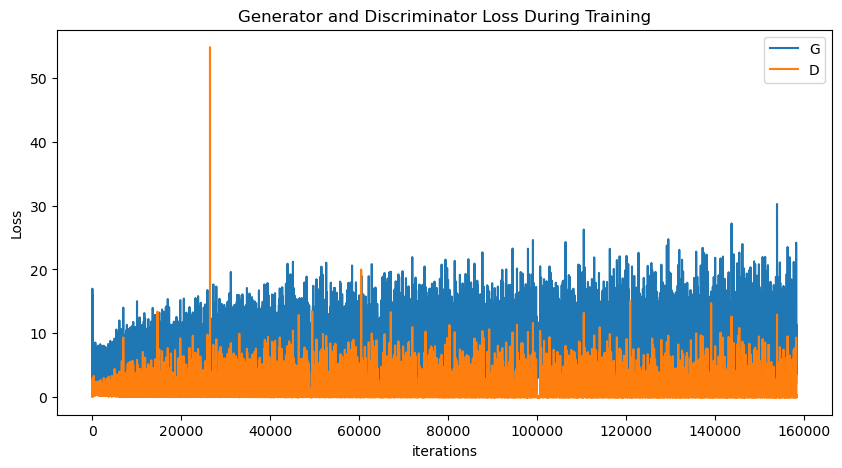

In [ ]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21146598 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


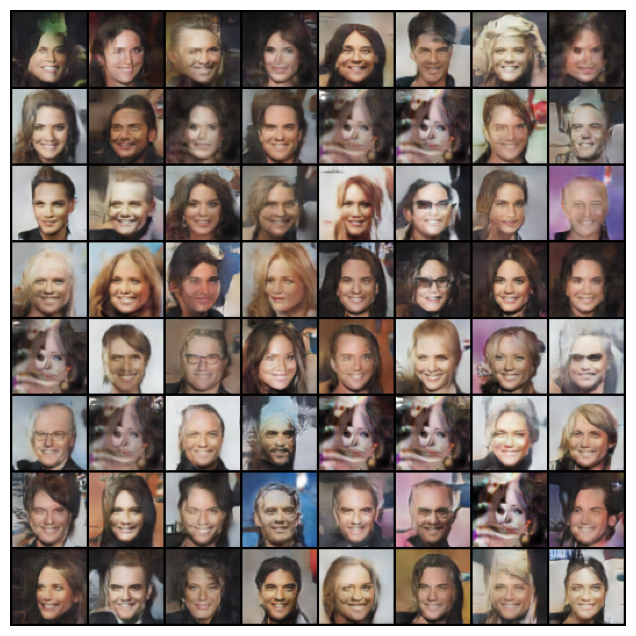

In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML


fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

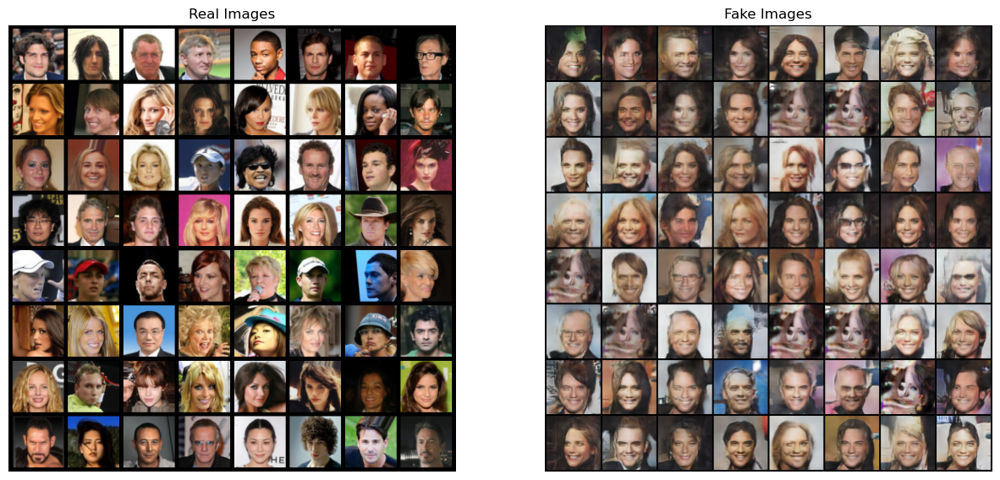

In [ ]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()